In [2]:
%load_ext autoreload
%autoreload 2

import torch
import torchaudio
import torchaudio.functional as F
import torchaudio.transforms as T

from audio_utils import print_stats, plot_waveform, plot_specgram, play_audio, plot_spectrogram

print(f"Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")
print(f"torchaudio {torchaudio.__version__}")

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
Using torch 1.9.1 (NVIDIA GeForce RTX 3060 Laptop GPU)
torchaudio 0.9.0a0+a85b239


In [3]:
wav_speech_path = 'data/audio/Wikipedia_Audio_-_2_Broadway.wav'
    
metadata = torchaudio.info(wav_speech_path)
print(metadata)

AudioMetaData(sample_rate=44100, num_frames=8053851, num_channels=2, bits_per_sample=16, encoding=PCM_S)


Sample Rate: 44100
Shape: (2, 8053851)
Dtype: torch.float32
 - Max:          0.733
 - Min:         -0.931
 - Mean:         0.000
 - Std Dev:  0.070

tensor([[ 0.0000,  0.0000,  0.0000,  ..., -0.0005, -0.0005, -0.0005],
        [ 0.0000,  0.0000,  0.0000,  ..., -0.0005, -0.0005, -0.0005]])



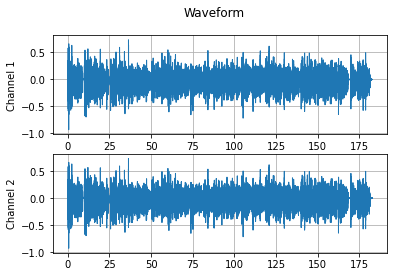

/home/xunwei/miniconda3/envs/asr/lib/python3.9/site-packages/matplotlib/axes/_axes.py:7723: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


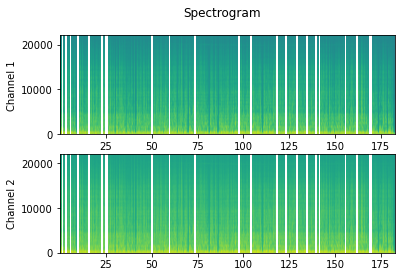

In [4]:
waveform, sample_rate = torchaudio.load(wav_speech_path)

print_stats(waveform, sample_rate=sample_rate)
plot_waveform(waveform, sample_rate)
plot_specgram(waveform, sample_rate)
play_audio(waveform, sample_rate)

In [7]:
waveform.shape

torch.Size([2, 8053851])

In [11]:
waveform_re = torch.mean(waveform, dim=0)#.unsqueeze(0)
waveform_re.shape

torch.Size([])

/home/xunwei/miniconda3/envs/asr/lib/python3.9/site-packages/torchaudio/functional/functional.py:432: UserWarning: At least one mel filterbank has all zero values. The value for `n_mels` (128) may be set too high. Or, the value for `n_freqs` (201) may be set too low.
  warnings.warn(


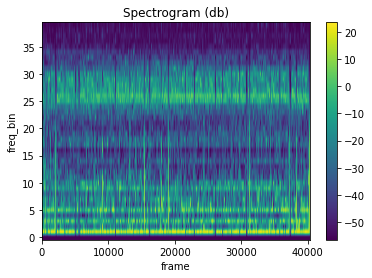

In [5]:
n_fft = 2048
win_length = None
hop_length = 512
n_mels = 256
n_mfcc = 256

# mfcc_transform = T.MFCC(
#     sample_rate=sample_rate,
#     n_mfcc=n_mfcc,
#     melkwargs={
#       'n_fft': n_fft,
#       'n_mels': n_mels,
#       'hop_length': hop_length,
#       'mel_scale': 'htk',
#     }
# )
mfcc_transform = T.MFCC()
mfcc = mfcc_transform(waveform)

plot_spectrogram(mfcc[0])

https://pytorch.org/audio/stable/transforms.html#mfcc

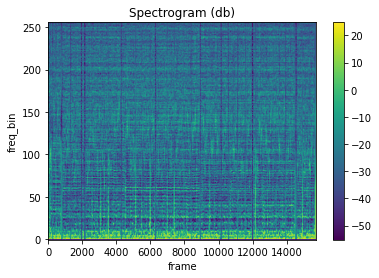

In [50]:
n_fft = 2048
win_length = None
hop_length = 512
n_mels = 256
n_mfcc = 256

mfcc_transform = T.MFCC(
    sample_rate=14000,
    n_mfcc=n_mfcc,
    melkwargs={
      'n_fft': n_fft,
      'n_mels': n_mels,
      'hop_length': hop_length,
      'mel_scale': 'htk',
    }
)

mfcc = mfcc_transform(waveform)

plot_spectrogram(mfcc[0])

In [6]:
import os
AUDIO_DIR = 'data/audio'
LABEL_DIR = 'data/label'

In [7]:
os.listdir(AUDIO_DIR)[0]

'Wikipedia_Audio_-_2_Broadway - Copy - Copy.wav'

In [8]:
os.path.join(AUDIO_DIR, os.listdir(AUDIO_DIR)[0])

'data/audio/Wikipedia_Audio_-_2_Broadway - Copy - Copy.wav'

In [9]:
for root, dirs, files in os.walk(AUDIO_DIR):
    print("Directory path: ", root)
    print("Folder name: ", dirs)
    print("File name: ", files)

Directory path:  data/audio
Folder name:  []
File name:  ['Wikipedia_Audio_-_2_Broadway - Copy - Copy.wav', 'Wikipedia_Audio_-_2_Broadway - Copy.wav', 'Wikipedia_Audio_-_2_Broadway.wav']


## Dataset

https://towardsdatascience.com/improves-cnn-performance-by-applying-data-transformation-bf86b3f4cef4
https://towardsdatascience.com/how-to-use-datasets-and-dataloader-in-pytorch-for-custom-text-data-270eed7f7c00

https://pytorch.org/tutorials/beginner/basics/data_tutorial.html

### Compress label into list

['Wikipedia_Audio_-_2_Broadway - Copy - Copy.txt',
 'Wikipedia_Audio_-_2_Broadway - Copy.txt',
 'Wikipedia_Audio_-_2_Broadway.txt']

In [77]:
labels = []
for file in os.listdir(LABEL_DIR):
    if file.endswith('.txt'):
        filepath = os.path.join(LABEL_DIR, file)
        with open(filepath) as f_input:
            labels.append(f_input.read())

print(labels)

['2 Broadway\nFrom Wikipedia, the free encyclopedia\n\n2 Broadway is an office building at the south end of Broadway, near Bowling Green Park in New York City. 2 Broadway was built on the site of the Produce Exchange Building, and now houses the headquarters of the Metropolitan Transportation Authority.\nDescription and history\nNew York Produce Exchange (1883)\n\nThe Produce Exchange was a representative structure of brick with terracotta decorations. Its grand skylighted hall, based on French retail structures, cast daylight into the lower floors. Its architect was George B. Post, who built it from 1881–84.\n\nThe Produce Exchange Building was demolished in 1957 and replaced by a 32-story tower constructed in 1958-1959. The developer, Uris Buildings Corporation, first preferred a design by William Lescaze with Kahn & Jacobs, which featured a tower slab set at right angles to Broadway. However, ultimately Emery Roth & Sons was given the contract, which saw a radically different design

In [79]:
class AudioDataset(torch.utils.data.Dataset):
    def __init__(self, audio_dir, labels, transform=None):
        self.labels = labels
        self.audio_dir = audio_dir
        self.transform = transform

    def __len__(self):
        'Denotes the total number of samples'
        return len(os.listdir(self.audio_dir))

    def __getitem__(self, index):
        'Generates one sample of data'
        audio_path = os.path.join(self.audio_dir, os.listdir(self.audio_dir)[index])
        waveform, sample_rate = torchaudio.load(audio_path)
        label = self.labels[index]
        if self.transform:
            waveform = self.transform(waveform)
        return waveform, label
    
n_fft = 2048
win_length = None
hop_length = 512
n_mels = 256
n_mfcc = 256
log_mels = True
sample_rate = 14000

mfcc_transform = T.MFCC(
    sample_rate=sample_rate,
    n_mfcc=n_mfcc,
    log_mels= log_mels,
    melkwargs={
      'n_fft': n_fft,
      'n_mels': n_mels,
      'hop_length': hop_length,
      'mel_scale': 'htk',
    }
)

In [82]:
training_data = AudioDataset(AUDIO_DIR, labels, mfcc_transform)
test_data = AudioDataset(AUDIO_DIR, labels, mfcc_transform)

print('First iteration of data set: ', next(iter(training_data)))
print(len(training_data))
print(len(test_data))

First iteration of data set:  (tensor([[[-2.1351e+02, -2.0790e+02, -2.0005e+02,  ..., -1.8977e+02,
          -1.9026e+02, -1.9243e+02],
         [ 2.4786e+00,  6.2433e+00,  1.2866e+01,  ...,  9.9424e+00,
           9.5723e+00,  8.8731e+00],
         [ 3.0741e+00,  3.0257e+00,  4.1742e+00,  ...,  8.3292e+00,
           7.8081e+00,  7.6515e+00],
         ...,
         [ 1.0791e-02, -1.1148e-01, -1.2015e-01,  ..., -1.2644e-01,
          -1.1843e-01,  1.7691e-01],
         [-9.1696e-02,  1.1041e-02,  2.5487e-01,  ...,  4.7900e-03,
           4.5669e-02, -1.2259e-01],
         [ 3.2021e-02,  1.4528e-01,  6.7707e-02,  ..., -5.2994e-02,
          -7.0070e-03,  2.3996e-02]],

        [[-2.1354e+02, -2.0799e+02, -2.0020e+02,  ..., -1.8921e+02,
          -1.8953e+02, -1.9183e+02],
         [ 2.6452e+00,  6.5818e+00,  1.2911e+01,  ...,  9.5407e+00,
           9.1678e+00,  8.3981e+00],
         [ 2.8022e+00,  3.1302e+00,  4.8809e+00,  ...,  8.1235e+00,
           7.8864e+00,  7.8531e+00],
        

## DataLoader

In [85]:
train_dataloader = torch.utils.data.DataLoader(training_data, batch_size=64, shuffle=True)
test_dataloader = torch.utils.data.DataLoader(test_data, batch_size=64, shuffle=True)

In [86]:
train_features, train_labels = next(iter(train_dataloader))
print(f"Feature batch shape: {train_features.size()}")

Feature batch shape: torch.Size([3, 2, 256, 15731])


In [87]:
train_labels

('2 Broadway\nFrom Wikipedia, the free encyclopedia\n\n2 Broadway is an office building at the south end of Broadway, near Bowling Green Park in New York City. 2 Broadway was built on the site of the Produce Exchange Building, and now houses the headquarters of the Metropolitan Transportation Authority.\nDescription and history\nNew York Produce Exchange (1883)\n\nThe Produce Exchange was a representative structure of brick with terracotta decorations. Its grand skylighted hall, based on French retail structures, cast daylight into the lower floors. Its architect was George B. Post, who built it from 1881–84.\n\nThe Produce Exchange Building was demolished in 1957 and replaced by a 32-story tower constructed in 1958-1959. The developer, Uris Buildings Corporation, first preferred a design by William Lescaze with Kahn & Jacobs, which featured a tower slab set at right angles to Broadway. However, ultimately Emery Roth & Sons was given the contract, which saw a radically different design

In [88]:
# Display image and label.
train_features, train_labels = next(iter(train_dataloader))
print(f"Feature batch shape: {train_features.size()}")
print(f"Labels batch shape: {train_labels.size()}")
img = train_features[0].squeeze()
label = train_labels[0]
plt.imshow(img, cmap="gray")
plt.show()
print(f"Label: {label}")

Feature batch shape: torch.Size([3, 2, 256, 15731])


AttributeError: 'tuple' object has no attribute 'size'